In [1]:
import pandas as pd
import numpy as np 
import seaborn as sns
import matplotlib.pyplot as plt

In [2]:
pd.set_option('max_colwidth', 400)
sns.set()

In [3]:
collisions = pd.read_csv('crimedata_csv_all_years/crimedata_csv_all_years.csv')
collisions.head()

,TYPE,YEAR,MONTH,DAY,HOUR,MINUTE,HUNDRED_BLOCK,NEIGHBOURHOOD,X,Y
0,Break and Enter Commercial,2012,12,14,8,52,NaN,Oakridge,491285.0000,5.453433e+06
1,Break and Enter Commercial,2019,3,7,2,6,10XX SITKA SQ,Fairview,490612.9648,5.457110e+06
2,Break and Enter Commercial,2019,8,27,4,12,10XX ALBERNI ST,West End,491007.7798,5.459174e+06
3,Break and Enter Commercial,2021,4,26,4,44,10XX ALBERNI ST,West End,491007.7798,5.459174e+06
4,Break and Enter Commercial,2014,8,8,5,13,10XX ALBERNI ST,West End,491015.9434,5.459166e+06


In [4]:
collisions['TYPE'].value_counts()

Theft from Vehicle                                        229391
Other Theft                                               198078
Mischief                                                   96203
Break and Enter Residential/Other                          70228
Offence Against a Person                                   69830
Break and Enter Commercial                                 44218
Theft of Vehicle                                           43352
Theft of Bicycle                                           34757
Vehicle Collision or Pedestrian Struck (with Injury)       27350
Vehicle Collision or Pedestrian Struck (with Fatality)       319
Homicide                                                     292
Name: TYPE, dtype: int64

In [5]:
# Consider only vehicular collision crimes
collisions = collisions[collisions['TYPE'].str.match(r'^Vehicle Collision.*$')]
collisions = collisions.rename(columns={'TYPE': 'Collision Type'})
collisions.head()

,Collision Type,YEAR,MONTH,DAY,HOUR,MINUTE,HUNDRED_BLOCK,NEIGHBOURHOOD,X,Y
786349,Vehicle Collision or Pedestrian Struck (with Fatality),2005,11,30,2,41,10XX BLOCK EXPO BLVD,Central Business District,491543.0,5458003.0
786350,Vehicle Collision or Pedestrian Struck (with Fatality),2005,11,11,1,10,10XX W HASTINGS ST,Central Business District,491461.0,5459401.0
786351,Vehicle Collision or Pedestrian Struck (with Fatality),2009,2,9,15,31,11XX BLOCK DAVIE ST,West End,490431.0,5458660.0
786352,Vehicle Collision or Pedestrian Struck (with Fatality),2006,10,22,22,26,11XX BLOCK E 60TH AVE,Sunset,493983.0,5451421.0
786353,Vehicle Collision or Pedestrian Struck (with Fatality),2018,12,27,5,1,11XX BLOCK KINGSWAY AVE,Kensington-Cedar Cottage,494071.0,5455562.0


In [6]:
traffic_cameras = pd.read_csv('web-cam-url-links.csv', sep=';')
traffic_cameras.head()

,Geom,MAPID,NAME,URL,Geo Local Area
0,"{""coordinates"": [-123.114967985868, 49.2603889490707], ""type"": ""Point""}",TCM007,Cambie St and W 12th Av,https://trafficcams.vancouver.ca/cambie12.htm,Fairview
1,"{""coordinates"": [-123.130252725283, 49.2084701202487], ""type"": ""Point""}",TCM010,Oak St and W 70th Av,https://trafficcams.vancouver.ca/oak4.htm,Marpole
2,"{""coordinates"": [-123.136787449782, 49.2942590380806], ""type"": ""Point""}",TCM014,Chilco St and W Georgia St,http://images.drivebc.ca/bchighwaycam/pub/html/www/19.html,West End
3,"{""coordinates"": [-123.136736007805, 49.2972589838826], ""type"": ""Point""}",TCM015,Stanley Park Causeway,http://images.drivebc.ca/bchighwaycam/pub/html/www/17.html,NaN
4,"{""coordinates"": [-123.129968, 49.324891], ""type"": ""Point""}",TCM017,North End 2,http://images.drivebc.ca/bchighwaycam/pub/html/www/20.html,NaN


In [7]:
intersections = pd.read_csv('street-intersections.csv', sep=';')
intersections.head()

,AT_STREET,ON_STREET,XSTREET,Geom,Geo Local Area
0,255.0,641.0,SEMLIN DRIVE AND E 6TH AV,"{""coordinates"": [-123.06390824405753, 49.26503329102706], ""type"": ""Point""}",Grandview-Woodland
1,270.0,638.0,E 5TH AV AND NANAIMO ST,"{""coordinates"": [-123.05659440978711, 49.26572903385497], ""type"": ""Point""}",Grandview-Woodland
2,271.0,638.0,KAMLOOPS ST AND E 5TH AV,"{""coordinates"": [-123.05469526101204, 49.26572832934466], ""type"": ""Point""}",Hastings-Sunrise
3,274.0,638.0,E 5TH AV AND PENTICTON ST,"{""coordinates"": [-123.05214709013256, 49.265726745970746], ""type"": ""Point""}",Hastings-Sunrise
4,225.0,730.0,E 33RD AV AND INVERNESS ST,"{""coordinates"": [-123.08025832293806, 49.240238447042834], ""type"": ""Point""}",Kensington-Cedar Cottage


In [8]:
from pyproj import Proj, transform

# Convert from UTM Zone 10 to WGS84 Longitude and Latitude
proj = Proj(proj='utm', zone=10, ellps='WGS84', preserve_units=False)
longitudes, latitudes = proj(collisions['X'], collisions['Y'], inverse=True)
collisions['longitude'] = np.round(longitudes, 6)
collisions['latitude'] = np.round(latitudes, 6)

In [9]:
collisions.replace(np.inf, np.nan, inplace=True)
collisions.dropna(subset=['longitude', 'latitude'], inplace=True)

collisions.drop(columns=['X', 'Y'], inplace=True)
collisions['coordinates (lat, lon)'] = collisions['latitude'].astype(str) + ', ' + collisions['longitude'].astype(str)
collisions['coordiantes (lat, lon)'] = collisions['coordinates (lat, lon)'].apply(lambda x: x.split(','))

collisions.head()

,Collision Type,YEAR,MONTH,DAY,HOUR,MINUTE,HUNDRED_BLOCK,NEIGHBOURHOOD,longitude,latitude,"coordinates (lat, lon)","coordiantes (lat, lon)"
786349,Vehicle Collision or Pedestrian Struck (with Fatality),2005,11,30,2,41,10XX BLOCK EXPO BLVD,Central Business District,-123.116264,49.274726,"49.274726, -123.116264","[49.274726, -123.116264]"
786350,Vehicle Collision or Pedestrian Struck (with Fatality),2005,11,11,1,10,10XX W HASTINGS ST,Central Business District,-123.117422,49.287300,"49.2873, -123.117422","[49.2873, -123.117422]"
786351,Vehicle Collision or Pedestrian Struck (with Fatality),2009,2,9,15,31,11XX BLOCK DAVIE ST,West End,-123.131568,49.280619,"49.280619, -123.131568","[49.280619, -123.131568]"
786352,Vehicle Collision or Pedestrian Struck (with Fatality),2006,10,22,22,26,11XX BLOCK E 60TH AVE,Sunset,-123.082621,49.215548,"49.215548, -123.082621","[49.215548, -123.082621]"
786353,Vehicle Collision or Pedestrian Struck (with Fatality),2018,12,27,5,1,11XX BLOCK KINGSWAY AVE,Kensington-Cedar Cottage,-123.081474,49.252798,"49.252798, -123.081474","[49.252798, -123.081474]"


In [10]:
import re 
coord_re = re.compile(r'^.*\[(-?\d+\.\d*,\s-?\d+\.\d*)\].*$')

def extract_coords(x): 
    match = coord_re.match(x)
    if match: 
        return match[1]
    else: 
        return None

traffic_cameras['coordinates'] = traffic_cameras['Geom'].apply(lambda x: extract_coords(x))
traffic_cameras.head()

,Geom,MAPID,NAME,URL,Geo Local Area,coordinates
0,"{""coordinates"": [-123.114967985868, 49.2603889490707], ""type"": ""Point""}",TCM007,Cambie St and W 12th Av,https://trafficcams.vancouver.ca/cambie12.htm,Fairview,"-123.114967985868, 49.2603889490707"
1,"{""coordinates"": [-123.130252725283, 49.2084701202487], ""type"": ""Point""}",TCM010,Oak St and W 70th Av,https://trafficcams.vancouver.ca/oak4.htm,Marpole,"-123.130252725283, 49.2084701202487"
2,"{""coordinates"": [-123.136787449782, 49.2942590380806], ""type"": ""Point""}",TCM014,Chilco St and W Georgia St,http://images.drivebc.ca/bchighwaycam/pub/html/www/19.html,West End,"-123.136787449782, 49.2942590380806"
3,"{""coordinates"": [-123.136736007805, 49.2972589838826], ""type"": ""Point""}",TCM015,Stanley Park Causeway,http://images.drivebc.ca/bchighwaycam/pub/html/www/17.html,NaN,"-123.136736007805, 49.2972589838826"
4,"{""coordinates"": [-123.129968, 49.324891], ""type"": ""Point""}",TCM017,North End 2,http://images.drivebc.ca/bchighwaycam/pub/html/www/20.html,NaN,"-123.129968, 49.324891"


In [11]:
intersections['coordinates'] = intersections['Geom'].apply(lambda x: extract_coords(x))
intersections.head()

,AT_STREET,ON_STREET,XSTREET,Geom,Geo Local Area,coordinates
0,255.0,641.0,SEMLIN DRIVE AND E 6TH AV,"{""coordinates"": [-123.06390824405753, 49.26503329102706], ""type"": ""Point""}",Grandview-Woodland,"-123.06390824405753, 49.26503329102706"
1,270.0,638.0,E 5TH AV AND NANAIMO ST,"{""coordinates"": [-123.05659440978711, 49.26572903385497], ""type"": ""Point""}",Grandview-Woodland,"-123.05659440978711, 49.26572903385497"
2,271.0,638.0,KAMLOOPS ST AND E 5TH AV,"{""coordinates"": [-123.05469526101204, 49.26572832934466], ""type"": ""Point""}",Hastings-Sunrise,"-123.05469526101204, 49.26572832934466"
3,274.0,638.0,E 5TH AV AND PENTICTON ST,"{""coordinates"": [-123.05214709013256, 49.265726745970746], ""type"": ""Point""}",Hastings-Sunrise,"-123.05214709013256, 49.265726745970746"
4,225.0,730.0,E 33RD AV AND INVERNESS ST,"{""coordinates"": [-123.08025832293806, 49.240238447042834], ""type"": ""Point""}",Kensington-Cedar Cottage,"-123.08025832293806, 49.240238447042834"


In [12]:
# From https://stackoverflow.com/questions/14745022/how-to-split-a-dataframe-string-column-into-two-columns
traffic_cameras[['longitude', 'latitude']] = traffic_cameras['coordinates'].str.split(',', 1, expand=True)
intersections[['longitude', 'latitude']] = intersections['coordinates'].str.split(',', 1, expand=True)

traffic_cameras = traffic_cameras.astype({'longitude': 'float64', 'latitude': 'float64'})
intersections = intersections.astype({'longitude': 'float64', 'latitude': 'float64'})

In [13]:
traffic_cameras = traffic_cameras.rename(columns={'TYPE': 'Signal Type'})
# traffic_cameras = traffic_cameras.round({'longitude': 6, 'latitude': 6})
traffic_cameras.head()

,Geom,MAPID,NAME,URL,Geo Local Area,coordinates,longitude,latitude
0,"{""coordinates"": [-123.114967985868, 49.2603889490707], ""type"": ""Point""}",TCM007,Cambie St and W 12th Av,https://trafficcams.vancouver.ca/cambie12.htm,Fairview,"-123.114967985868, 49.2603889490707",-123.114968,49.260389
1,"{""coordinates"": [-123.130252725283, 49.2084701202487], ""type"": ""Point""}",TCM010,Oak St and W 70th Av,https://trafficcams.vancouver.ca/oak4.htm,Marpole,"-123.130252725283, 49.2084701202487",-123.130253,49.208470
2,"{""coordinates"": [-123.136787449782, 49.2942590380806], ""type"": ""Point""}",TCM014,Chilco St and W Georgia St,http://images.drivebc.ca/bchighwaycam/pub/html/www/19.html,West End,"-123.136787449782, 49.2942590380806",-123.136787,49.294259
3,"{""coordinates"": [-123.136736007805, 49.2972589838826], ""type"": ""Point""}",TCM015,Stanley Park Causeway,http://images.drivebc.ca/bchighwaycam/pub/html/www/17.html,NaN,"-123.136736007805, 49.2972589838826",-123.136736,49.297259
4,"{""coordinates"": [-123.129968, 49.324891], ""type"": ""Point""}",TCM017,North End 2,http://images.drivebc.ca/bchighwaycam/pub/html/www/20.html,NaN,"-123.129968, 49.324891",-123.129968,49.324891


In [14]:
# From https://stackoverflow.com/questions/27928/calculate-distance-between-two-latitude-longitude-points-haversine-formula
def get_distance_between_two_points(lon1, lat1, lon2, lat2):

    R = 6371 # Radius of the earth in km

    dLat = to_radians(lat2-lat1) 
    dLon = to_radians(lon2-lon1) 
    a = np.sin(dLat/2) * np.sin(dLat/2) + \
    np.cos(to_radians(lat1)) * np.cos(to_radians(lat2)) * \
    np.sin(dLon/2) * np.sin(dLon/2)

    c = 2 * np.arctan2(np.sqrt(a), np.sqrt(1-a))
    d = R * c 
    return d * 1000 # Distance in metres


def to_radians(deg):
    return deg * (np.pi/180)


In [15]:
# Exclude accidents that did not occur at (near) an intersection 
def find_nearest_intersection(entry): 
    longitude = entry['longitude']
    latitude = entry['latitude']
    
    distances = get_distance_between_two_points(longitude, latitude, intersections['longitude'], intersections['latitude'])
    coordinates_and_dists = [list(x) for x in zip(distances, intersections['coordinates'])]
    
    # From https://stackoverflow.com/questions/16036913/minimum-of-list-of-lists
    # Gets the 'minimum' array of coordinates_and_dists, defined by the the array that has the smallest value in its first index 
    # (this is its distance to the nearest intersection)
    nearest_inter_dist_and_coords = min((x for x in coordinates_and_dists), key=lambda x: x[0])
    
    nearest_inter_dist_and_coords = str(nearest_inter_dist_and_coords)
    nearest_inter_dist_and_coords = nearest_inter_dist_and_coords.replace('\'', '')
    nearest_inter_dist_and_coords = nearest_inter_dist_and_coords.replace(' ', '', 1) # Only replace the first instance of a space. The second one is the space between long, lat
    
    return str(nearest_inter_dist_and_coords)[1:-1]

collisions['nearest_inter_dist_and_coords'] = collisions.apply(lambda x: find_nearest_intersection(x), axis=1)
collisions[['nearest_inter_dist', 'nearest_inter_coords']] = collisions['nearest_inter_dist_and_coords'].str.split(',', 1, expand=True)

collisions.head()

,Collision Type,YEAR,MONTH,DAY,HOUR,MINUTE,HUNDRED_BLOCK,NEIGHBOURHOOD,longitude,latitude,"coordinates (lat, lon)","coordiantes (lat, lon)",nearest_inter_dist_and_coords,nearest_inter_dist,nearest_inter_coords
786349,Vehicle Collision or Pedestrian Struck (with Fatality),2005,11,30,2,41,10XX BLOCK EXPO BLVD,Central Business District,-123.116264,49.274726,"49.274726, -123.116264","[49.274726, -123.116264]","25.778879249304573,-123.11597597673139, 49.27486177637614",25.778879249304573,"-123.11597597673139, 49.27486177637614"
786350,Vehicle Collision or Pedestrian Struck (with Fatality),2005,11,11,1,10,10XX W HASTINGS ST,Central Business District,-123.117422,49.287300,"49.2873, -123.117422","[49.2873, -123.117422]","34.98138915330925,-123.11702347327036, 49.287122804707316",34.98138915330925,"-123.11702347327036, 49.287122804707316"
786351,Vehicle Collision or Pedestrian Struck (with Fatality),2009,2,9,15,31,11XX BLOCK DAVIE ST,West End,-123.131568,49.280619,"49.280619, -123.131568","[49.280619, -123.131568]","37.50813340742894,-123.13119696849375, 49.28038405688184",37.50813340742894,"-123.13119696849375, 49.28038405688184"
786352,Vehicle Collision or Pedestrian Struck (with Fatality),2006,10,22,22,26,11XX BLOCK E 60TH AVE,Sunset,-123.082621,49.215548,"49.215548, -123.082621","[49.215548, -123.082621]","38.033465366942266,-123.08314462996795, 49.215548309346765",38.033465366942266,"-123.08314462996795, 49.215548309346765"
786353,Vehicle Collision or Pedestrian Struck (with Fatality),2018,12,27,5,1,11XX BLOCK KINGSWAY AVE,Kensington-Cedar Cottage,-123.081474,49.252798,"49.252798, -123.081474","[49.252798, -123.081474]","27.20312723216086,-123.08180777572436, 49.25268670717523",27.20312723216086,"-123.08180777572436, 49.25268670717523"


In [16]:
# Remove accidents that did not occur within 50m of an intersection
collisions = collisions.astype({'nearest_inter_dist': 'float64'})
collisions = collisions[collisions['nearest_inter_dist'] < 50]

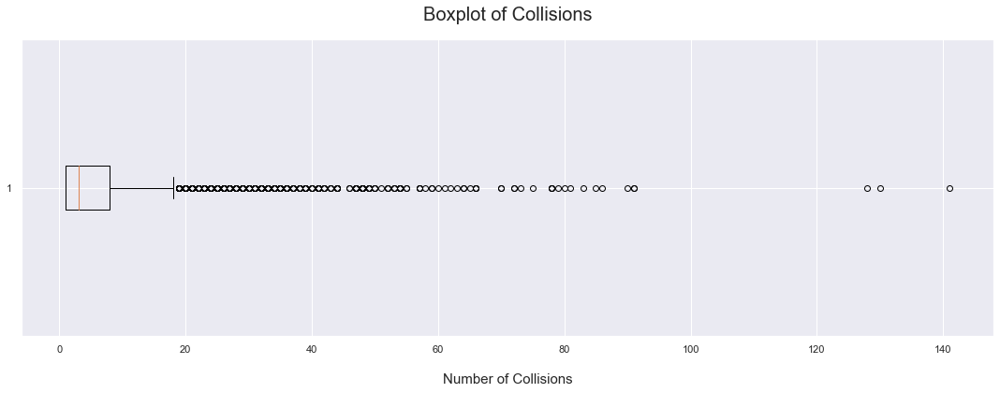

In [17]:
collisions_grouped = collisions.groupby(by=['nearest_inter_coords']).count()['YEAR'] # The number of collisions at each intersection

figure = plt.figure(figsize=(15,6))
axis = plt.gca()

plt.boxplot(collisions_grouped, vert=False)

axis.set_xlabel('Number of Collisions', fontsize=15, labelpad=20)
axis.set_title('Boxplot of Collisions', fontsize=20, pad=20)

figure.tight_layout()
plt.show()

In [18]:
collisions_grouped.describe()

count    3325.000000
mean        7.478195
std        11.840645
min         1.000000
25%         1.000000
50%         3.000000
75%         8.000000
max       141.000000
Name: YEAR, dtype: float64

There are so many oultiers! The median number of collisions is 3, but the highest number of collisions is 141.

In [19]:
# Determine if accident occured at an intersection with traffic cameras
def at_intersection_with_camera(entry): 
    longitude = entry['longitude']
    latitude = entry['latitude']
    
    distances = get_distance_between_two_points(longitude, latitude, traffic_cameras['longitude'], traffic_cameras['latitude'])
    
    # Check if the nearest traffic camera is within 50 metres
    return True if np.min(distances) < 50 else False

collisions['intersection_with_camera'] = collisions.apply(lambda x: at_intersection_with_camera(x), axis=1)

In [20]:
import folium
from folium.plugins import MarkerCluster

In [21]:
map = folium.Map(
    location=[49.246292, -123.116226], # Latitude and Longitude for Vancouver, starting position 
    zoom_start=13.25
)

In [22]:
def add_marker(entry, color, group, opacity=1):
    folium.CircleMarker(
        location=[entry['latitude'], entry['longitude']],
        radius=2,
        color=color,
        opacity=opacity, 
        fill=True,
        fill_opacity=opacity
    ).add_to(group)

# From https://github.com/python-visualization/folium/issues/528
collision_points = folium.FeatureGroup(name='<span style=\\"color: red;\\">Collisions</span>')
camera_points = folium.FeatureGroup(name='<span style=\\"color: blue;\\">Traffic Cameras</span>')

collision_clusters = MarkerCluster().add_to(collision_points)

collisions.apply(lambda x: add_marker(x, 'red', collision_clusters, 0.6), axis=1)
traffic_cameras.apply(lambda x: add_marker(x, 'blue', camera_points), axis=1)

collision_points.add_to(map)
camera_points.add_to(map)

folium.map.LayerControl('topright', collapsed=False).add_to(map)

map

In [23]:
no_traffic_cameras = collisions[~collisions['intersection_with_camera']]
traffic_cameras = collisions[collisions['intersection_with_camera']]

In [24]:
no_traffic_cameras_counts = no_traffic_cameras.groupby(by=['nearest_inter_coords']).count()['Collision Type']
traffic_cameras_counts = traffic_cameras.groupby(by=['nearest_inter_coords']).count()['Collision Type']

In [25]:
import matplotlib.pyplot as plt 

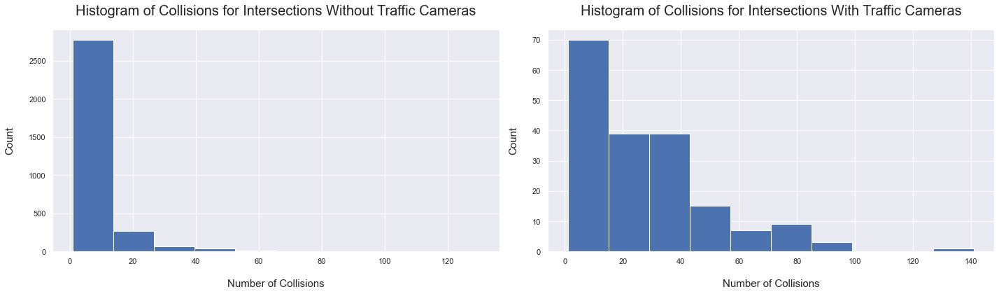

In [26]:
figure, (axis_1, axis_2) = plt.subplots(1, 2, figsize=(20, 6))

axis_1.hist(no_traffic_cameras_counts)
axis_2.hist(traffic_cameras_counts)

axis_1.set_xlabel('Number of Collisions', fontsize=15, labelpad=20)
axis_1.set_ylabel('Count', fontsize=15, labelpad=20)
axis_1.set_title('Histogram of Collisions for Intersections Without Traffic Cameras', fontsize=20, pad=20)

axis_2.set_xlabel('Number of Collisions', fontsize=15, labelpad=20)
axis_2.set_ylabel('Count', fontsize=15, labelpad=20)
axis_2.set_title('Histogram of Collisions for Intersections With Traffic Cameras', fontsize=20, pad=20)

figure.tight_layout()
plt.show()

The distributions are not normally distributed. Transforming with sqrt or log doesn't seem to do much. Let's proceed with a non-parametric test instead.

In [27]:
import scipy.stats as stats 

In [28]:
U1, p = stats.mannwhitneyu(no_traffic_cameras_counts, traffic_cameras_counts)
p

8.164900371071897e-47

Since p-value << 0.5, we strongly reject the null hypothesis that the number of accidents at intersections with and without cameras are the same. 

Perhaps intersections with traffic cameras have less accidents that are fatal? Let's investigate. 

In [29]:
fatal_re = re.compile(r'^.*\(with Fatality\)$')

def is_fatal(x): 
    match = fatal_re.match(x)
    if match: 
        return True
    else: 
        return False

In [30]:
traffic_cameras = traffic_cameras.copy()
no_traffic_cameras = no_traffic_cameras.copy()

traffic_cameras['Fatal'] = traffic_cameras['Collision Type'].apply(lambda x: is_fatal(x))
no_traffic_cameras['Fatal'] = no_traffic_cameras['Collision Type'].apply(lambda x: is_fatal(x))

In [31]:
fatal_count = traffic_cameras.groupby(by=['Fatal']).count().reset_index()['Collision Type']
fatal_count_no_cameras = no_traffic_cameras.groupby(by=['Fatal']).count().reset_index()['Collision Type']

contingency = [list(fatal_count), list(fatal_count_no_cameras)]
contingency

[[4738, 40], [19862, 225]]

In [32]:
chi2, p, dof, expected = stats.chi2_contingency(contingency)
print(p)
print(expected)

0.10233680709484297
[[ 4727.0782224    50.9217776]
 [19872.9217776   214.0782224]]


Since p-value > 0.05, there isn't sufficient evidence to conclude that traffic cameras impact whether or not an accident is fatal!

Looking at the sample we've given: 

In [33]:
no_traffic_cameras_counts_avg = np.mean(no_traffic_cameras_counts)
traffic_cameras_counts_avg = np.mean(traffic_cameras_counts)
no_traffic_cameras_counts_avg, traffic_cameras_counts_avg

(6.334594765058341, 26.10928961748634)

Interesting! So the average number of collisions at intersections with traffic cameras is actually HIGHER than that of intersections without traffic cameras. 

However, we must note that we do not have access to when these traffic cameras were installed. The most plausible explanation for this is: these traffic cameras are deliberately installed at the selected intersections precisely because accidents have occured there often. Moreover, intersections with traffic cameras are very busy as they are major streets. Hence, there is a higher liklihood for accidents to occur at such locations compared to intersections that are not as busy.  

According to https://maps.vancouver.ca/portal/home/webmap/viewer.html?useExisting=1&layers=2341279204664720a5c82672c07f6d44, it appears that there is more "movement" at intersections with traffic cameras. 

Let's try repeating the aforementioend calculations without outliers: 

In [39]:
fil_collisions_grouped = collisions.groupby(by=['nearest_inter_coords', 'intersection_with_camera']).count()['YEAR']

q1 = np.percentile(fil_collisions_grouped, 25)
q3 = np.percentile(fil_collisions_grouped, 75)

iqr = q3 - q1

upper = fil_collisions_grouped > (q3 + 1.5*iqr)
lower = fil_collisions_grouped < (q1 - 1.5*iqr)

fil_collisions_grouped = fil_collisions_grouped[~upper & ~lower] # Ensure that number of collisions is between q1 - 1.5 * iqr and q3 + 1.5 * iqr

In [40]:
# Revert to dataframe after performing groupby
fil_collisions_grouped = fil_collisions_grouped.to_frame().reset_index()

In [41]:
fil_camera = fil_collisions_grouped[fil_collisions_grouped['intersection_with_camera']] 
fil_no_camera = fil_collisions_grouped[~fil_collisions_grouped['intersection_with_camera']] 

In [42]:
U1, p = stats.mannwhitneyu(no_traffic_cameras_counts, traffic_cameras_counts)
p

8.164900371071897e-47

Again, we see that p-value << 0.5 so, we strongly reject the null hypothesis that the number of accidents at intersections with and without cameras are the same (for outliers removed). 

In [55]:
fil_collisions = fil_collisions_grouped.merge(collisions, on=['intersection_with_camera', 'nearest_inter_coords'], how='inner')
fil_collisions['Fatal'] = fil_collisions['Collision Type'].apply(lambda x: is_fatal(x))

fil_collisions_camera = fil_collisions[fil_collisions['intersection_with_camera']]
fil_collisions_no_camera = fil_collisions[~fil_collisions['intersection_with_camera']]

fil_collisions_camera_count = fil_collisions_camera.groupby(by=['Fatal']).count()['Collision Type']
fil_collisions_no_camera_count = fil_collisions_no_camera.groupby(by=['Fatal']).count()['Collision Type']

contingency  = [list(fil_collisions_no_camera_count), list(fil_collisions_camera_count)]
contingency

[[12020, 135], [655, 9]]

In [56]:
chi2, p, dof, expected = stats.chi2_contingency(contingency)
print(p)
print(expected)

0.693816090880838
[[1.20184589e+04 1.36541072e+02]
 [6.56541072e+02 7.45892815e+00]]


Like the previous chi-square calculation with outliers, here we have p-value > 0.5, so there is no sufficient evidence to conclude that traffic cameras have an effect on the fatality of accidents.  

Let's return to the original dataset and perform some analyses on when accidents occur. 

In [193]:
collisions['Fatal'] = collisions['Collision Type'].apply(lambda x: is_fatal(x))
collisions_by_year = collisions.groupby(by=['YEAR', 'Fatal']).agg(total_collisions_by_year = ('YEAR', 'count')).reset_index()

In [196]:
def plot_collisions_by_year(collisions_by_year): 
    
    collisions_by_year_fatal = collisions_by_year[collisions_by_year['Fatal']]
    collisions_by_year_nonfatal = collisions_by_year[~collisions_by_year['Fatal']]

    figure, (axis_1, axis_2) = plt.subplots(1, 2, figsize=(20, 7))

    axis_1.plot(collisions_by_year_nonfatal['YEAR'], collisions_by_year_nonfatal['total_collisions_by_year'], linewidth=5, label='Nonfatal Collisions')
    axis_1.set_xlabel('Year', fontsize=15, labelpad=20)
    axis_1.set_ylabel('Number of Collisions', fontsize=15, labelpad=20)
    axis_1.set_title('Number of Nonfatal Collisions by Year (at Intersections in Vancouver)', fontsize=20, pad=20)
    axis_1.xaxis.set_major_locator(plt.MaxNLocator(20))
    axis_1.yaxis.set_major_locator(plt.MaxNLocator(integer=True))
    plt.setp(axis_1.xaxis.get_majorticklabels(), rotation=90)
    axis_1.legend()

    axis_2.plot(collisions_by_year_fatal['YEAR'], collisions_by_year_fatal['total_collisions_by_year'], linewidth=5, color='red', label='Fatal Collisions')
    axis_2.set_xlabel('Year', fontsize=15, labelpad=20)
    axis_2.set_ylabel('Number of Collisions', fontsize=15, labelpad=20)
    axis_2.set_title('Number of Fatal Collisions by Year (at Intersections in Vancouver)', fontsize=20, pad=20)
    axis_2.xaxis.set_major_locator(plt.MaxNLocator(20))
    axis_2.yaxis.set_major_locator(plt.MaxNLocator(integer=True))
    # From https://stackoverflow.com/questions/11264521/date-ticks-and-rotation-in-matplotlib
    plt.setp(axis_2.xaxis.get_majorticklabels(), rotation=90)
    axis_2.legend()

    plt.tight_layout()
    plt.show()

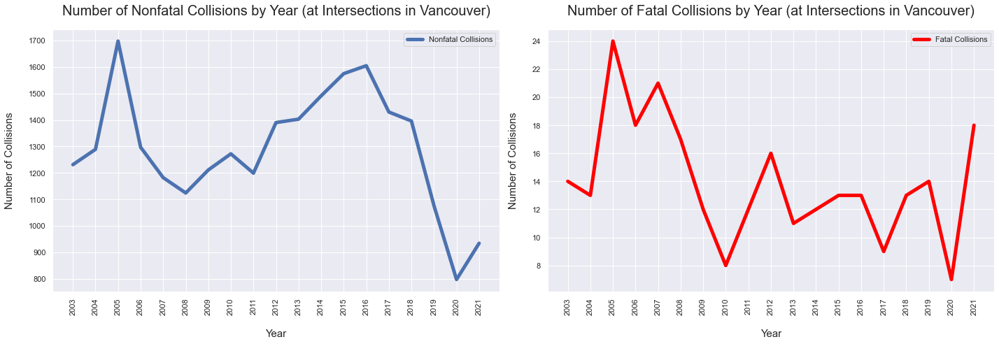

In [197]:
plot_collisions_by_year(collisions_by_year)

Looks like there is a decrease in the number of nonfatal accidents between 2016 and 2020. The number of fatal collisions doesn't seem to follow the same trend though. 

Let's take a look at the number of collisions by month. 

In [305]:
def plot_collisions_by_month(collisions_by_month, year=None): 
    
    collisions_by_month_fatal = collisions_by_month[collisions_by_month['Fatal']]
    collisions_by_month_nonfatal = collisions_by_month[~collisions_by_month['Fatal']]

    figure, (axis_1, axis_2) = plt.subplots(1, 2, figsize=(20, 7))
    
    axis_1.plot(collisions_by_month_nonfatal['MONTH'], collisions_by_month_nonfatal['total_collisions_by_month'], linewidth=5, label='Nonfatal Collisions')
    axis_1.set_xlabel('Month', fontsize=15, labelpad=20)
    axis_1.set_ylabel('Number of Collisions', fontsize=15, labelpad=20)
    axis_1.set_title('Number of Nonfatal Collisons by Month (at Intersections in Vancouver)', fontsize=20, pad=20)
    axis_1.set_xticks(ticks=np.arange(1, 13))
    axis_1.set_xticklabels(labels=months)
    plt.setp(axis_1.xaxis.get_majorticklabels(), rotation=90)
    axis_1.legend()

    axis_2.plot(collisions_by_month_fatal['MONTH'], collisions_by_month_fatal['total_collisions_by_month'], color='red', linewidth=5, label='Fatal Collisions')
    axis_2.set_xlabel('Month', fontsize=15, labelpad=20)
    axis_2.set_ylabel('Number of Collisions', fontsize=15, labelpad=20)
    axis_2.set_title('Number of Fatal Collisions by Month (at Intersections in Vancouver)', fontsize=20, pad=20)
    axis_2.set_xticks(ticks=np.arange(1, 13))
    axis_2.set_xticklabels(labels=months)
    plt.setp(axis_2.xaxis.get_majorticklabels(), rotation=90)
    axis_2.legend()

    # If plotting for a particular year instead of the total of all of them
    if year: 
        figure.suptitle('YEAR: ' + str(year), fontsize=30, y=1) # y is the padding 
        
    plt.tight_layout()
    plt.show()

In [306]:
import calendar 

collisions_by_month = collisions.groupby(by=['MONTH', 'Fatal']).agg(total_collisions_by_month = ('YEAR', 'count')).reset_index()

months = []
for index, month in enumerate(calendar.month_name):
    if month: 
        months.append(month)

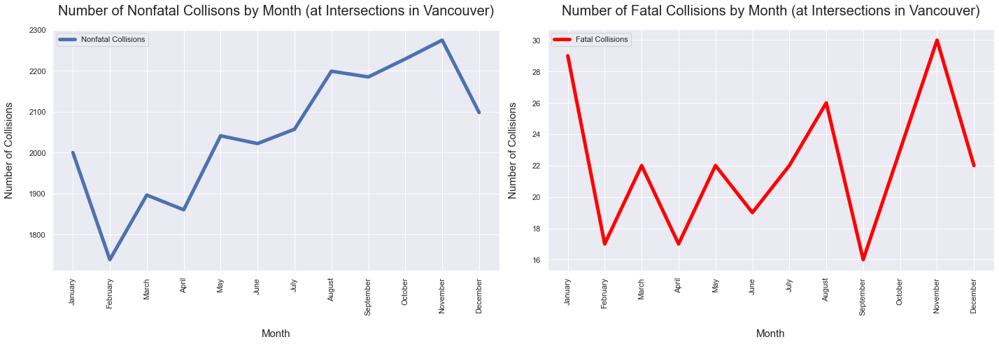

In [307]:
plot_collisions_by_month(collisions_by_month)

There is an apparent increasing trend in the the number of nonfatal collisions through the year. Fatal and nonfatal accidents seem to the highest during the end of the year, dips slightly in December, and increases again in January. This could be attributed to the holiday season and snowy weather. 

Let's visualize the trend of these collisions by year. 

In [308]:
import ipywidgets as widgets

In [328]:
collisions_grouped = collisions.groupby(by=['YEAR', 'MONTH', 'Fatal']).count()['Collision Type'].reset_index()
collisions_grouped = collisions_grouped.rename(columns={'Collision Type': 'total_collisions_by_month'})
collisions_grouped.head()

,YEAR,MONTH,Fatal,total_collisions_by_month
0,2003,1,False,102
1,2003,1,True,2
2,2003,2,False,72
3,2003,3,False,82
4,2003,3,True,2


In [342]:
dropdown = widgets.Dropdown(
            options=collisions_grouped['YEAR'].unique(),
            value=collisions_grouped['YEAR'][0], 
            description='Select a Year: ',
            style={'description_width': 'initial'}
        )

In [343]:
# Inspired from https://github.com/jupyter-widgets/ipywidgets/issues/2148
output = widgets.Output()

@output.capture()
def on_dropdown_change(change_info):
    output.clear_output()
    selected_year = change_info['new'] # Stores the updated value
    new_plot = collisions_grouped[collisions_grouped['YEAR'] == selected_year]
    plot_collisions_by_month(new_plot, selected_year)

In [344]:
# Plot the first item in the dropdown as default
with output: 
    first_year = collisions_grouped['YEAR'][0]
    new_plot = collisions_grouped[collisions_grouped['YEAR'] == first_year]
    plot_collisions_by_month(new_plot, first_year)

In [345]:
dropdown.observe(on_dropdown_change, names='value')

In [346]:
display(dropdown)
display(output)

Dropdown(description='Select a Year: ', options=(2003, 2004, 2005, 2006, 2007, 2008, 2009, 2010, 2011, 2012, 2…

Output(outputs=({'output_type': 'display_data', 'data': {'text/plain': '<Figure size 1440x504 with 2 Axes>', '…